<a href="https://colab.research.google.com/github/dreamcatcher1712/face-mask-detection/blob/main/AI_DEC_2022_Ayushi_Gupta__.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


1/1 [==============================] - 0s 30ms/step


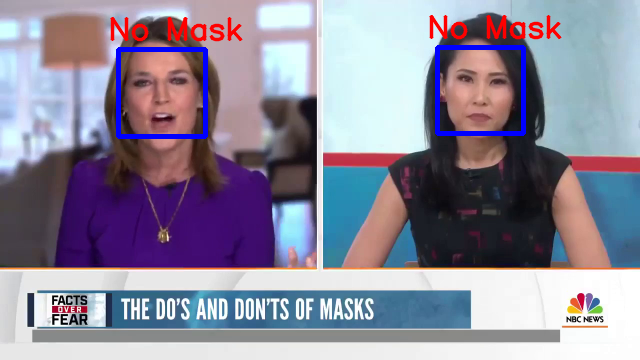

1/1 [==============================] - 0s 31ms/step


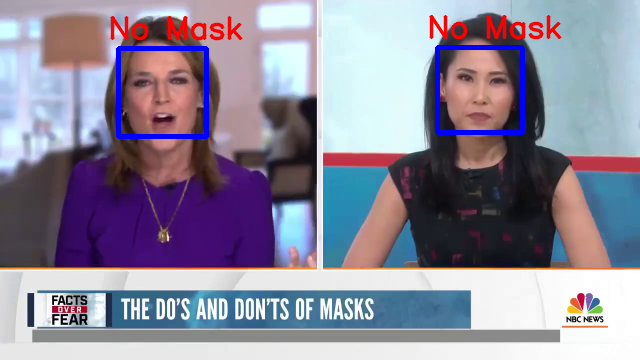

1/1 [==============================] - 0s 28ms/step


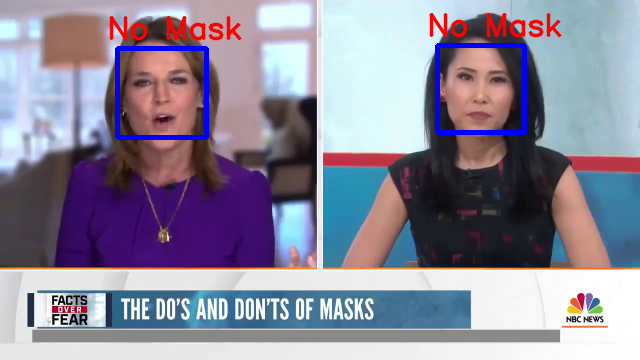

1/1 [==============================] - 0s 29ms/step


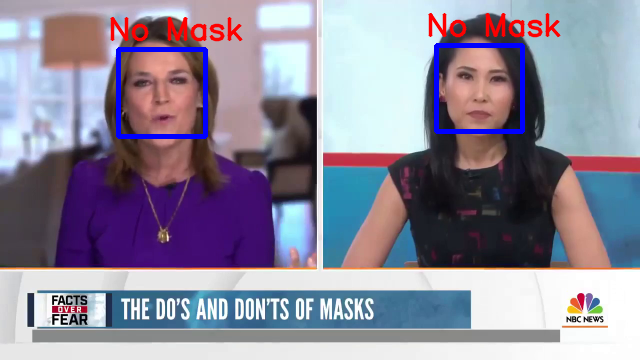

1/1 [==============================] - 0s 30ms/step


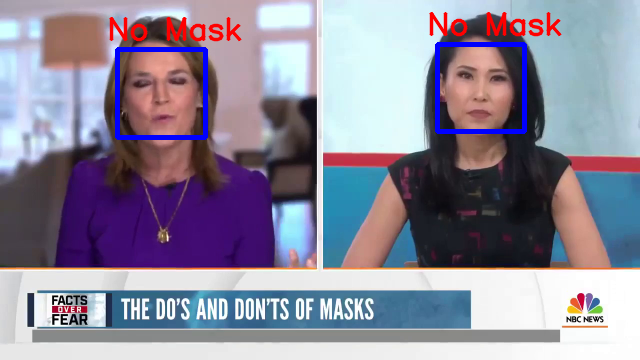

1/1 [==============================] - 0s 31ms/step


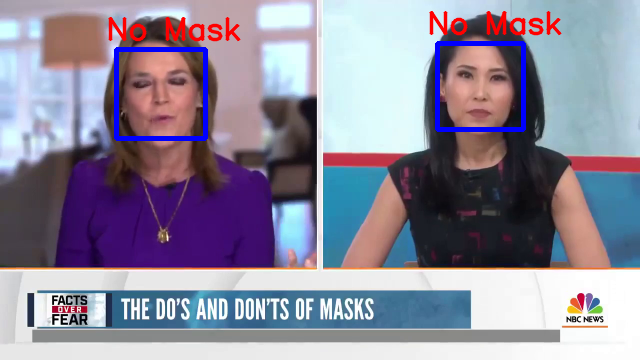

1/1 [==============================] - 0s 33ms/step


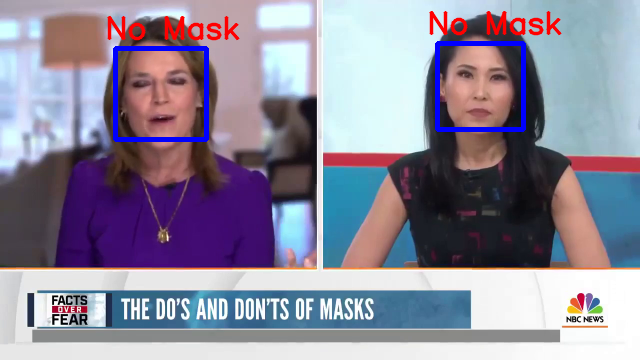

1/1 [==============================] - 0s 32ms/step


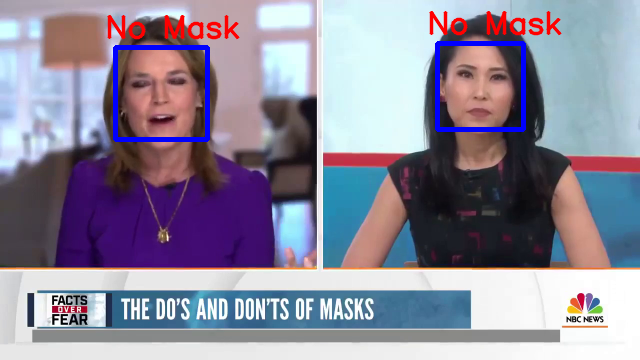

1/1 [==============================] - 0s 34ms/step


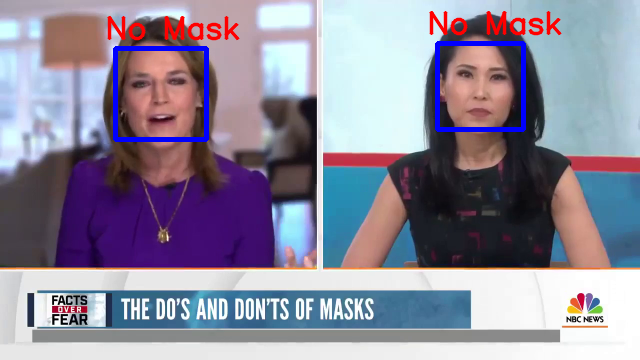

1/1 [==============================] - 0s 30ms/step


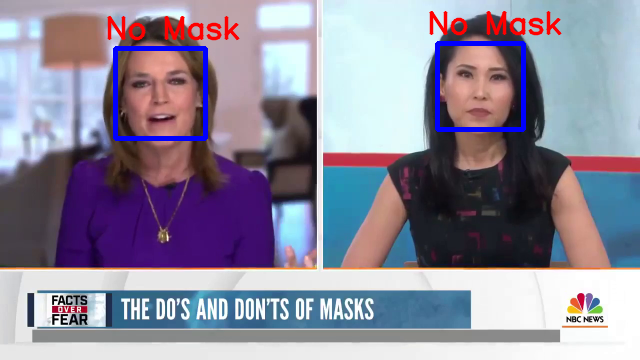

1/1 [==============================] - 0s 33ms/step


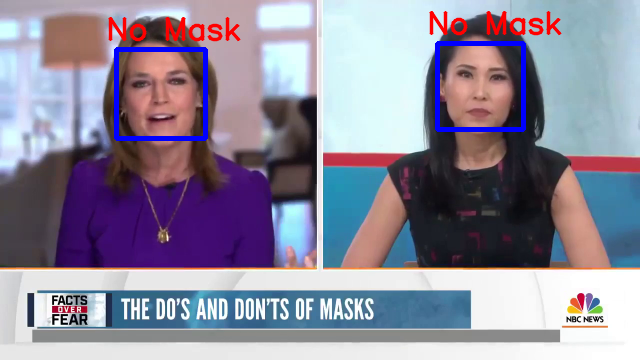

1/1 [==============================] - 0s 29ms/step


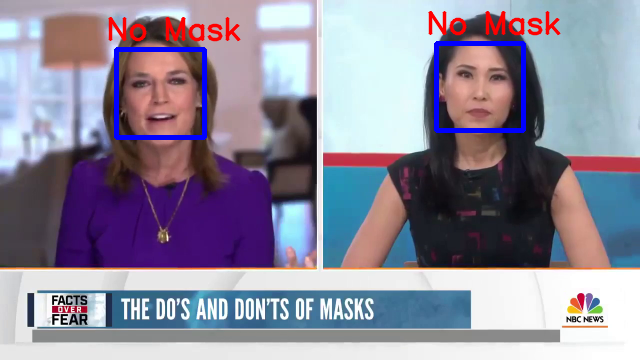

1/1 [==============================] - 0s 42ms/step


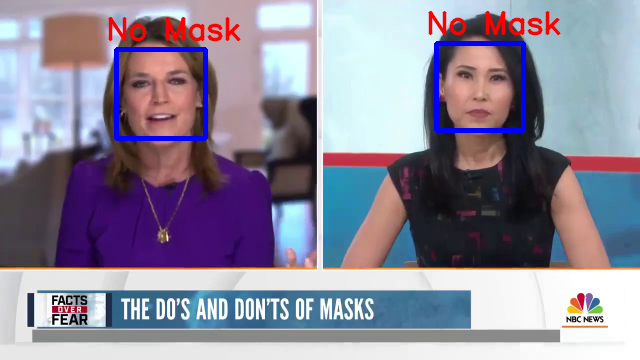

1/1 [==============================] - 0s 31ms/step


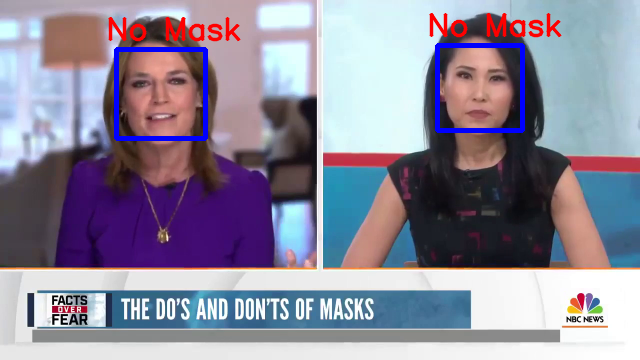

1/1 [==============================] - 0s 31ms/step


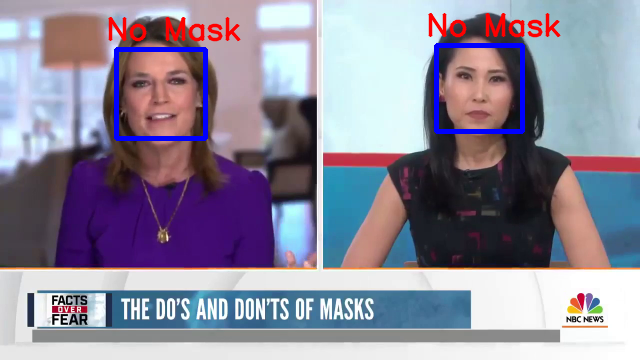

1/1 [==============================] - 0s 34ms/step


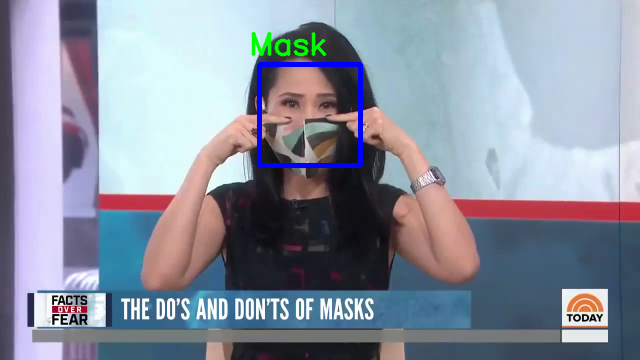

1/1 [==============================] - 0s 43ms/step


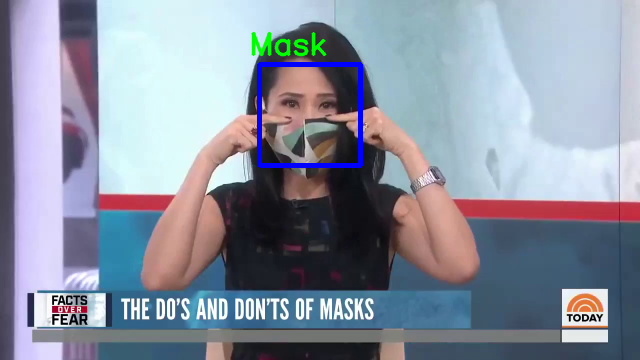

1/1 [==============================] - 0s 30ms/step


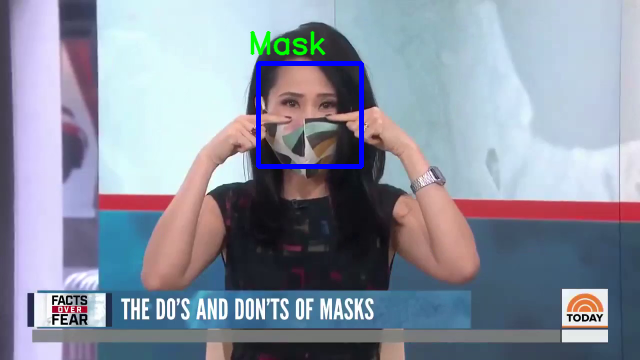

1/1 [==============================] - 0s 29ms/step


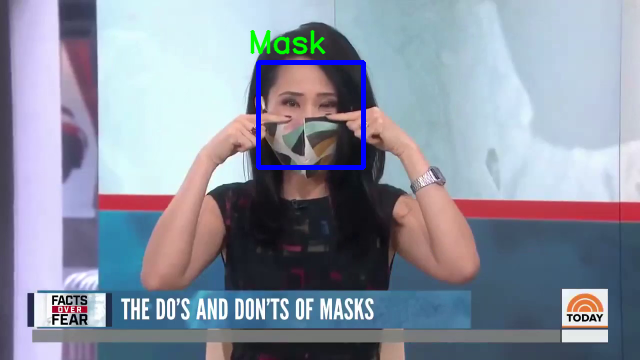

1/1 [==============================] - 0s 30ms/step


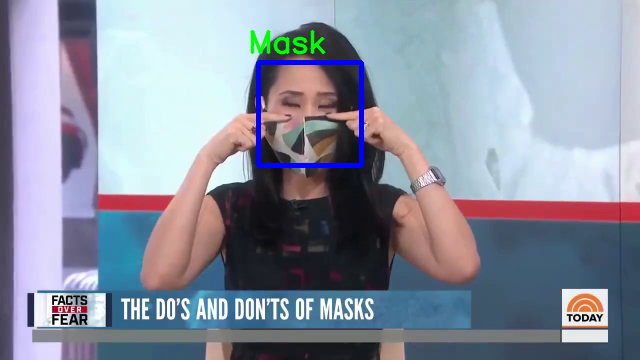

1/1 [==============================] - 0s 31ms/step


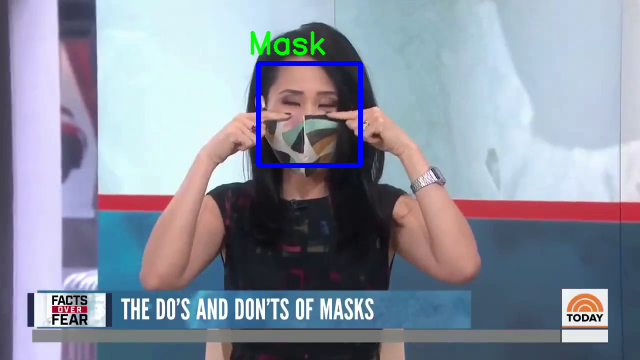

1/1 [==============================] - 0s 33ms/step


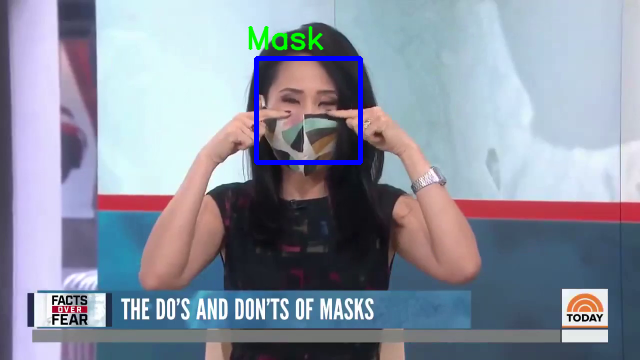

1/1 [==============================] - 0s 34ms/step


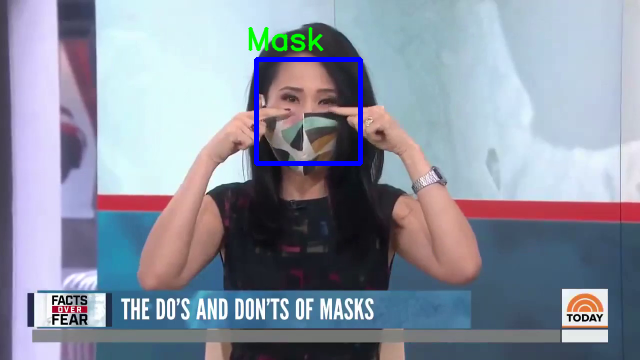

1/1 [==============================] - 0s 31ms/step


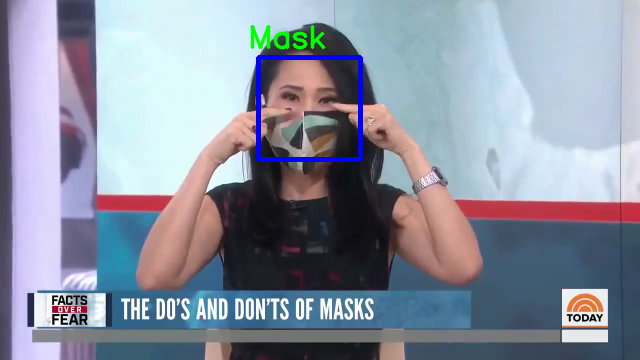

1/1 [==============================] - 0s 29ms/step


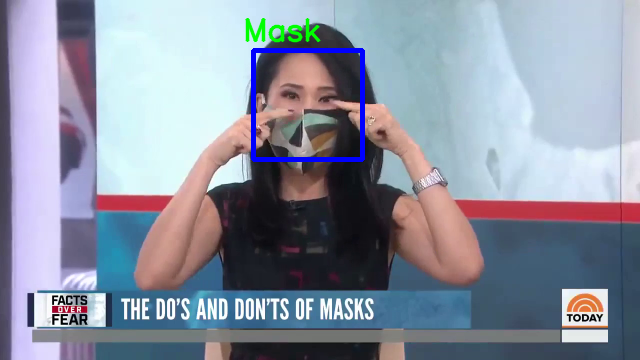

1/1 [==============================] - 0s 31ms/step


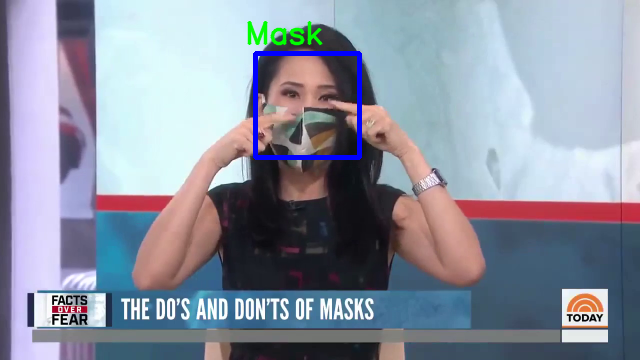

1/1 [==============================] - 0s 31ms/step


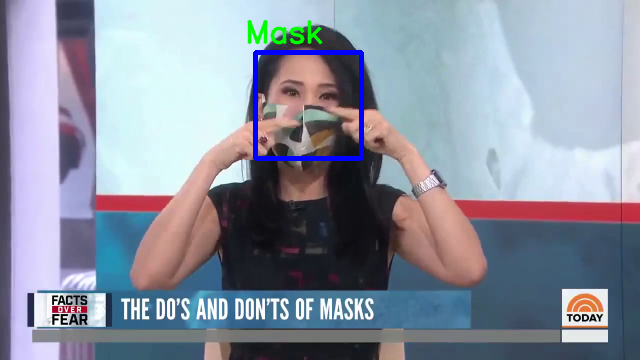

1/1 [==============================] - 0s 32ms/step


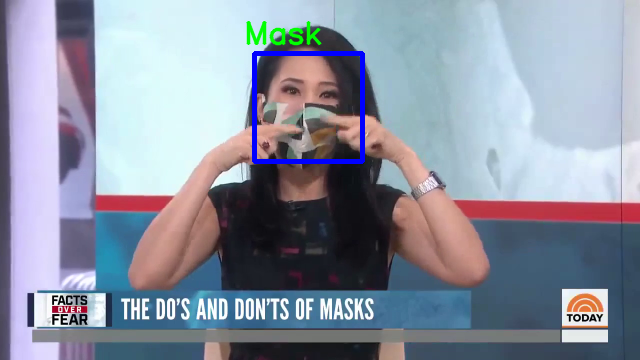

1/1 [==============================] - 0s 32ms/step


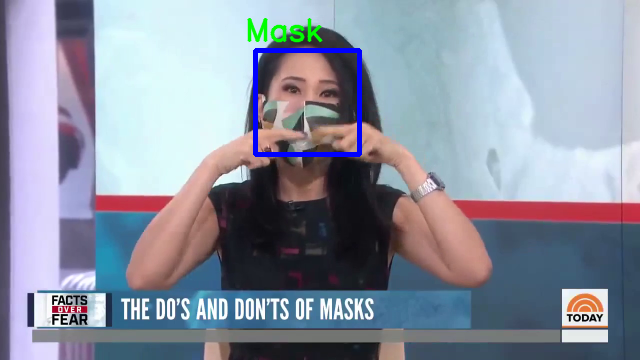

1/1 [==============================] - 0s 30ms/step


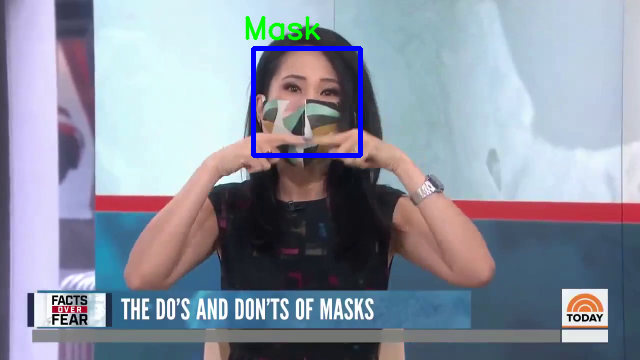

1/1 [==============================] - 0s 31ms/step


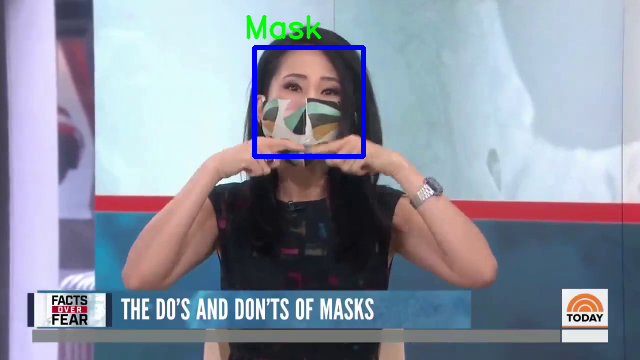

1/1 [==============================] - 0s 33ms/step


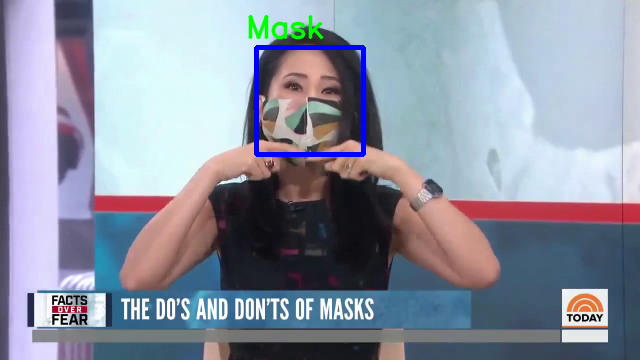

1/1 [==============================] - 0s 30ms/step


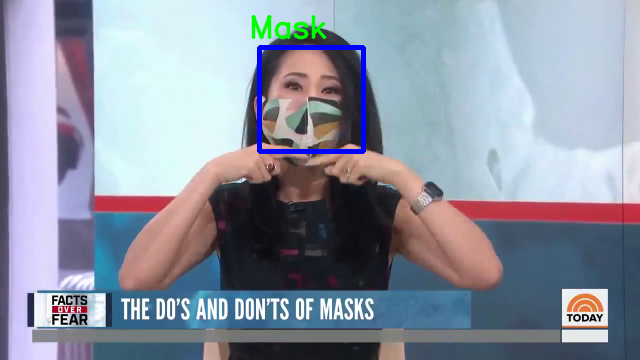

1/1 [==============================] - 0s 35ms/step


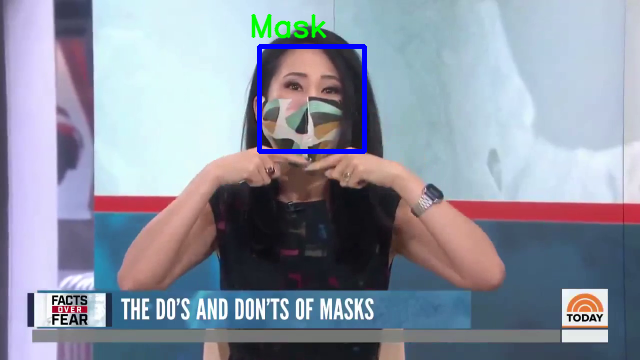

1/1 [==============================] - 0s 29ms/step


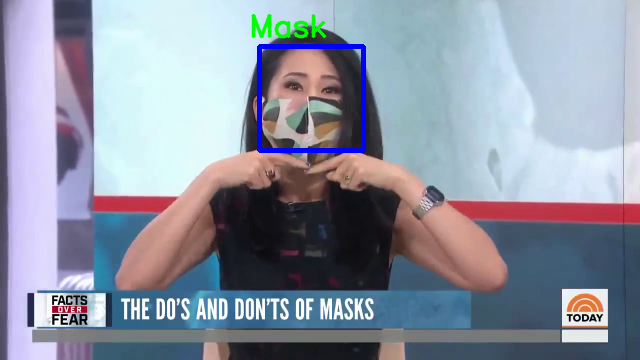

1/1 [==============================] - 0s 30ms/step


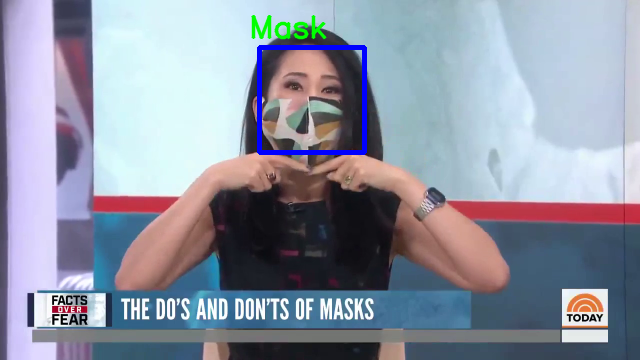

1/1 [==============================] - 0s 31ms/step


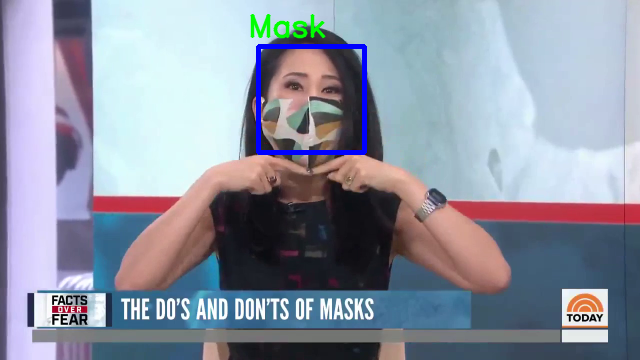

1/1 [==============================] - 0s 32ms/step


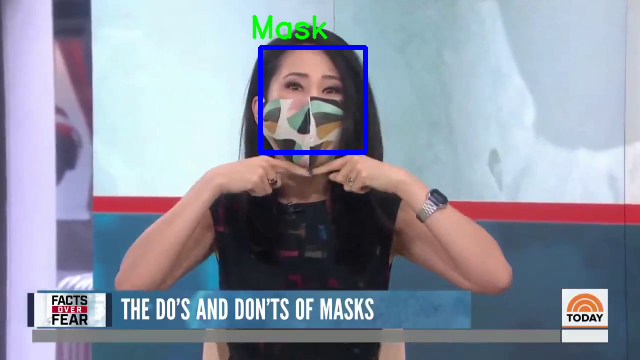

1/1 [==============================] - 0s 34ms/step


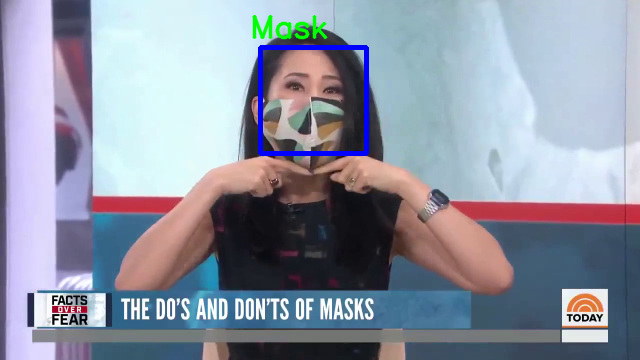

1/1 [==============================] - 0s 31ms/step


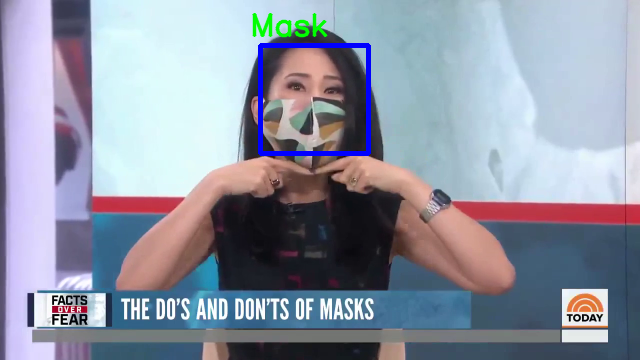

1/1 [==============================] - 0s 32ms/step


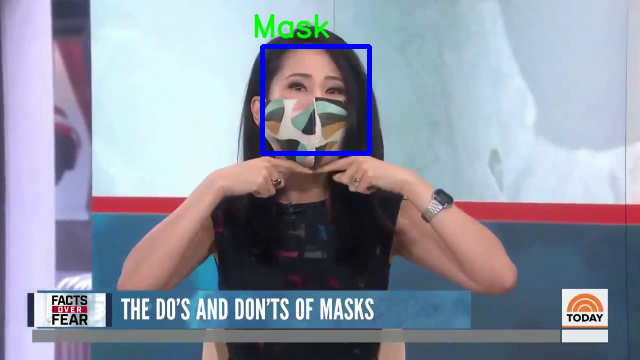

1/1 [==============================] - 0s 31ms/step


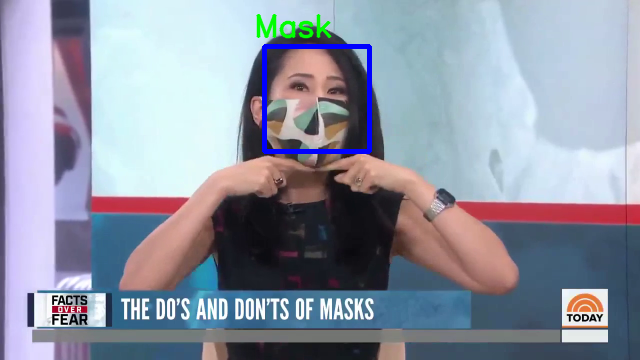

1/1 [==============================] - 0s 29ms/step


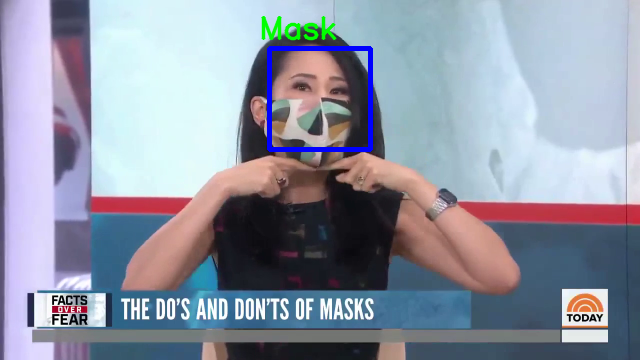

1/1 [==============================] - 0s 29ms/step


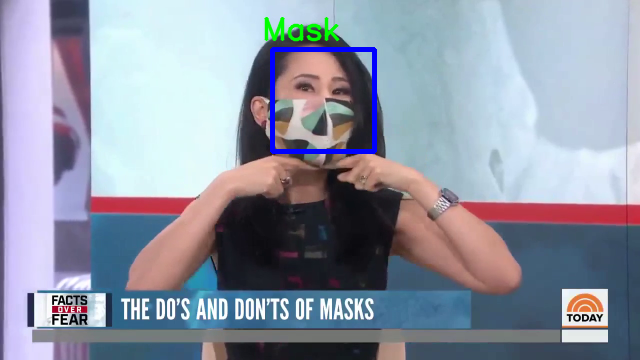

1/1 [==============================] - 0s 29ms/step


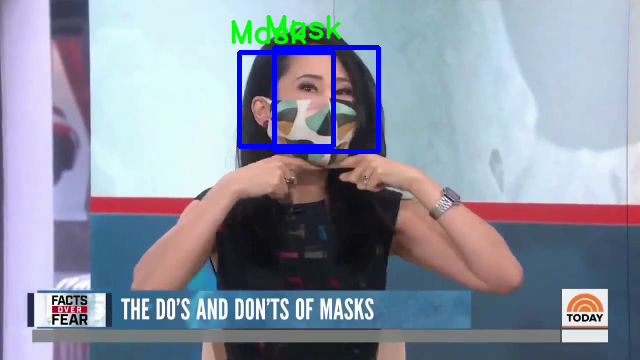

1/1 [==============================] - 0s 30ms/step


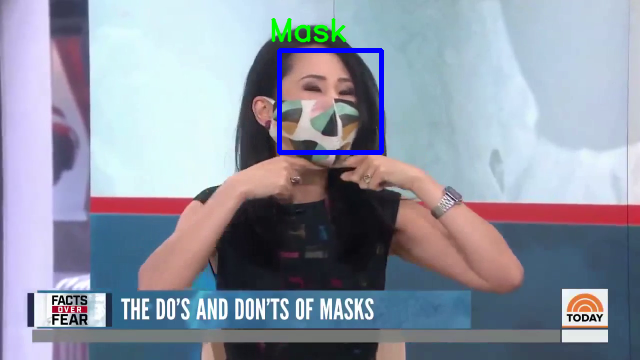

1/1 [==============================] - 0s 31ms/step


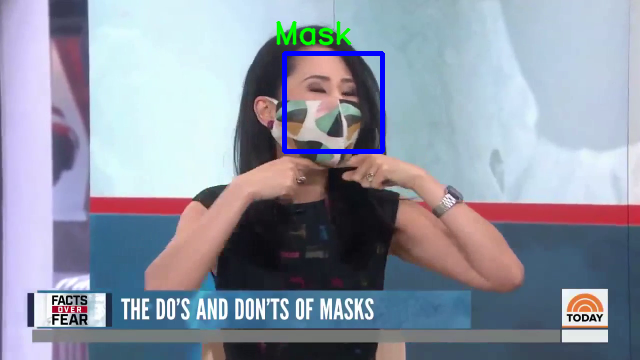

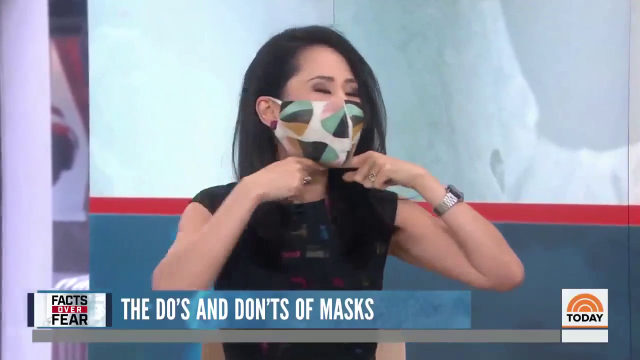

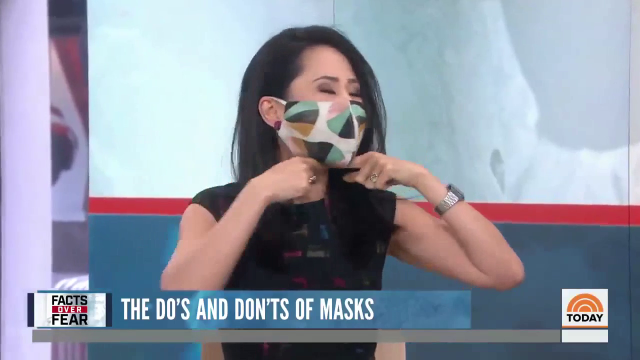

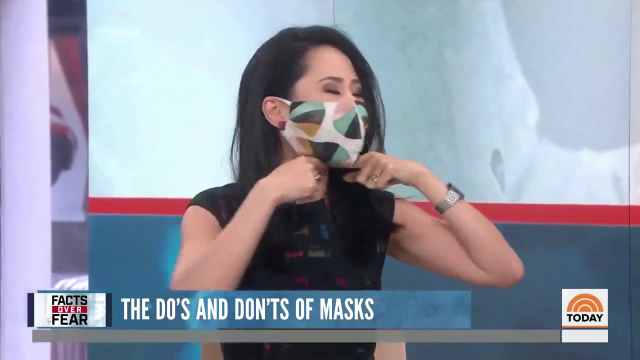

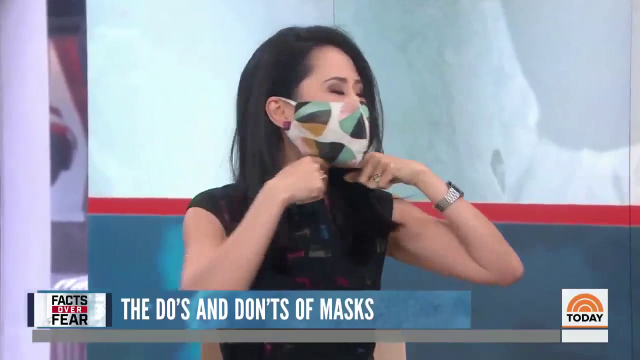

...

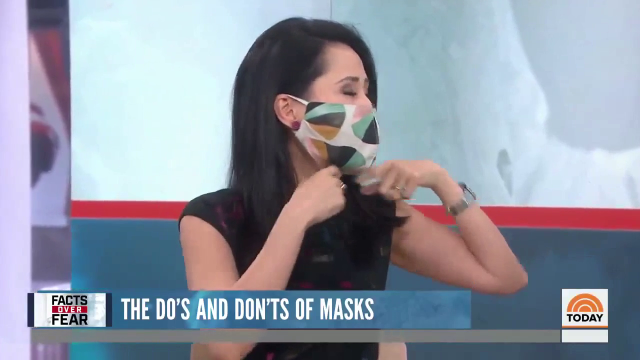

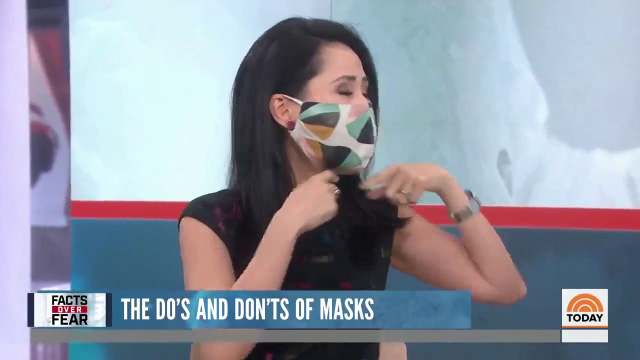

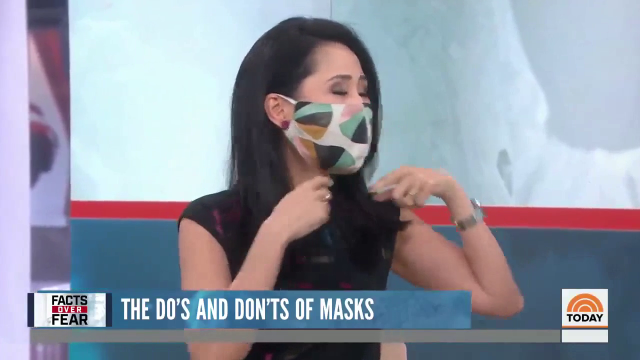

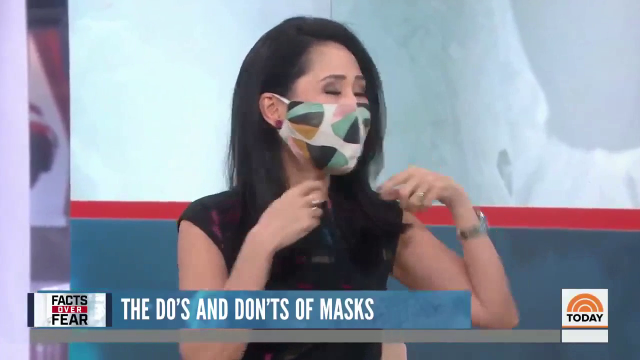

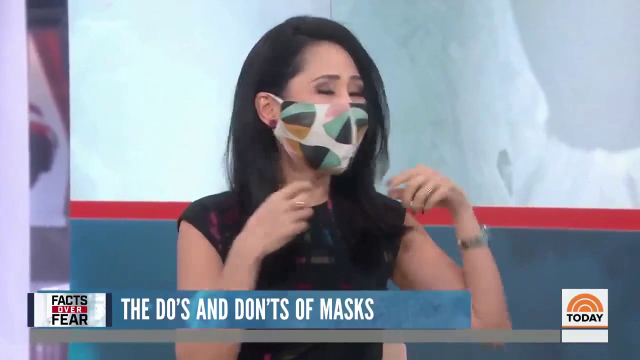

1/1 [==============================] - 0s 38ms/step


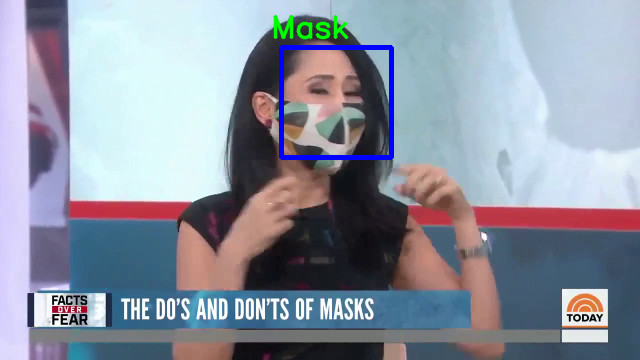

1/1 [==============================] - 0s 30ms/step


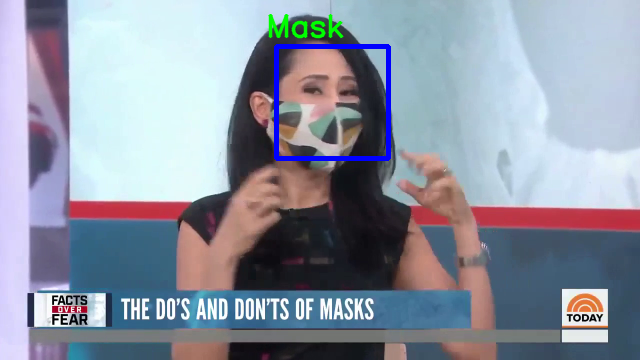

1/1 [==============================] - 0s 31ms/step


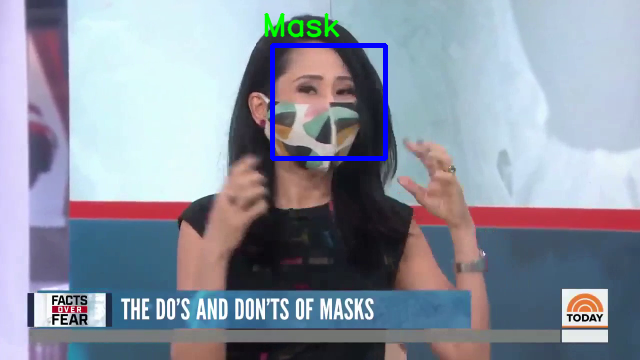

1/1 [==============================] - 0s 32ms/step


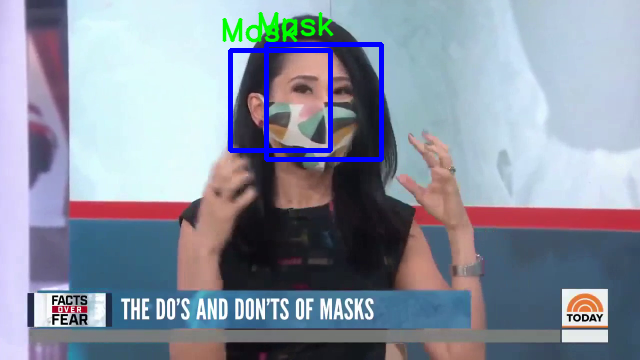

1/1 [==============================] - 0s 31ms/step


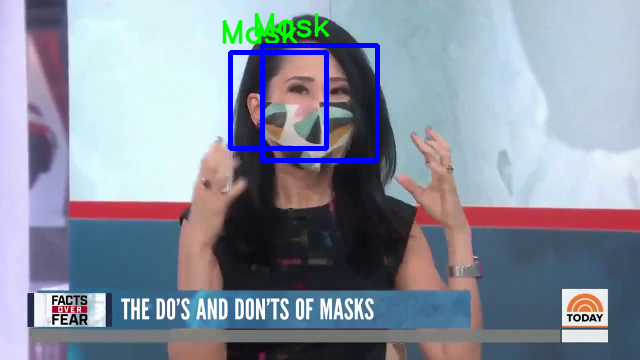

1/1 [==============================] - 0s 31ms/step


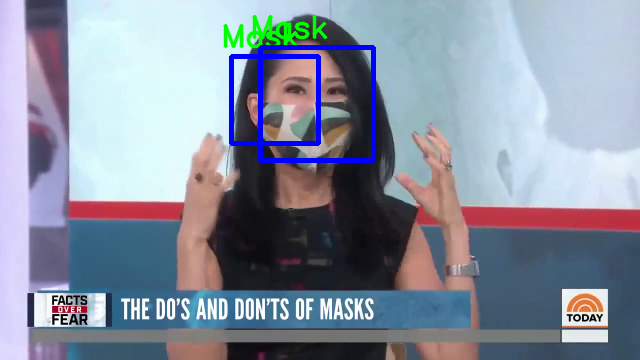

1/1 [==============================] - 0s 31ms/step


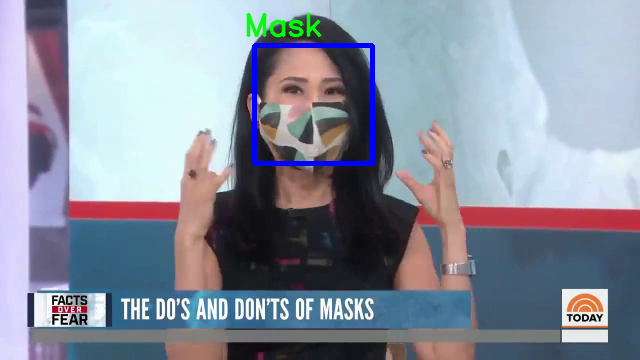

1/1 [==============================] - 0s 29ms/step


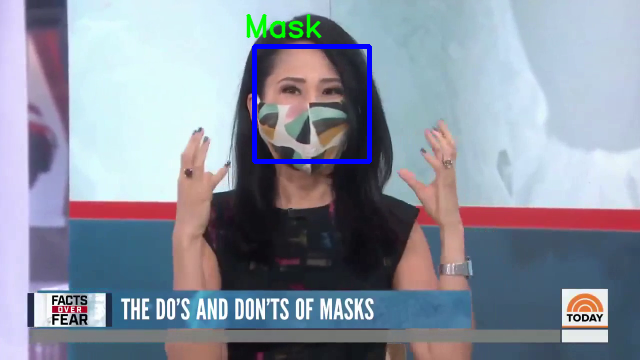

1/1 [==============================] - 0s 29ms/step


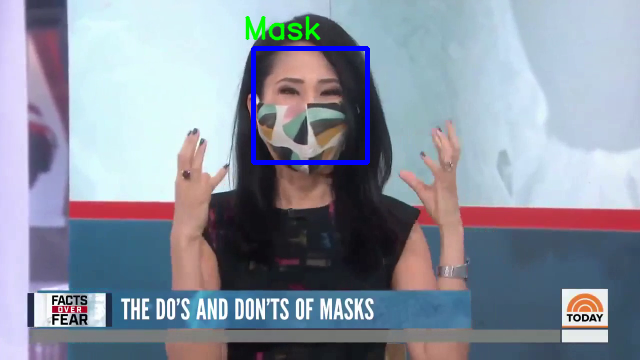

1/1 [==============================] - 0s 30ms/step


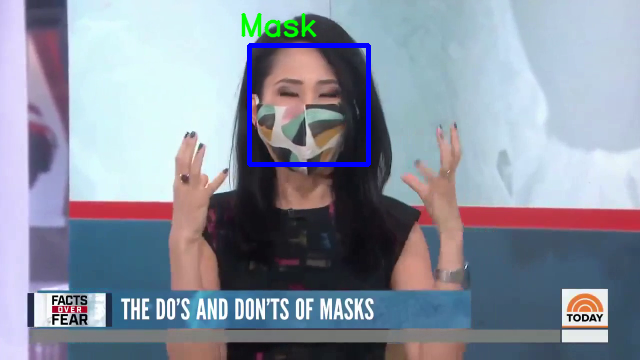

1/1 [==============================] - 0s 30ms/step


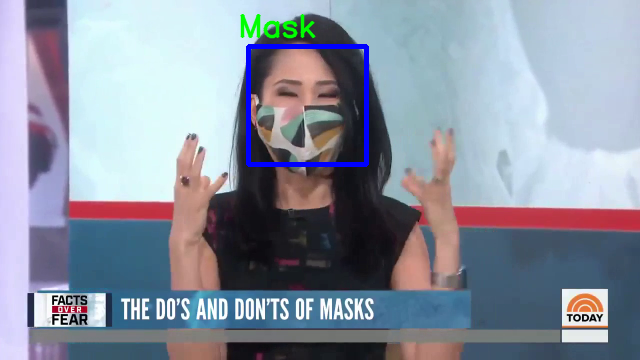

1/1 [==============================] - 0s 30ms/step


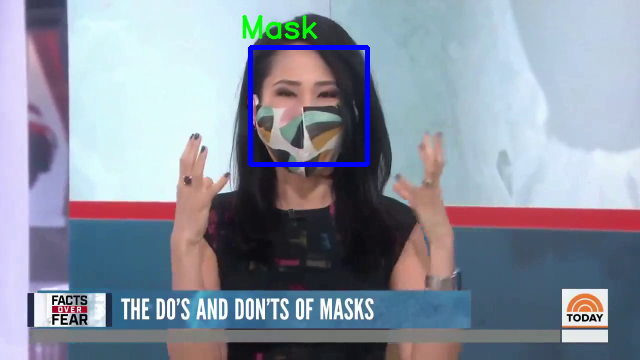

1/1 [==============================] - 0s 30ms/step


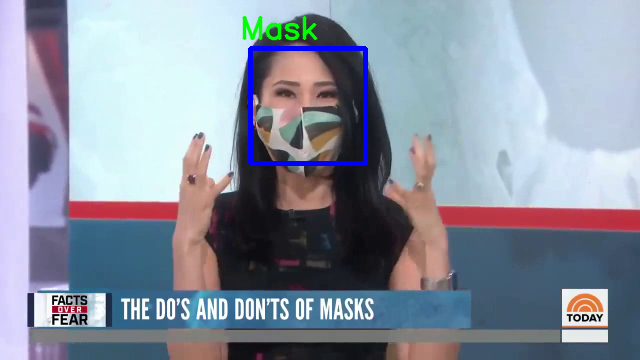

1/1 [==============================] - 0s 42ms/step


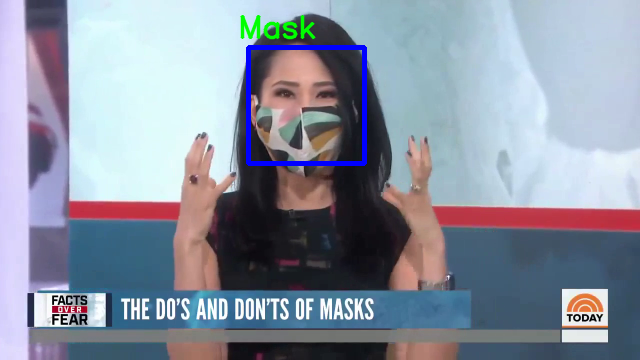

1/1 [==============================] - 0s 30ms/step


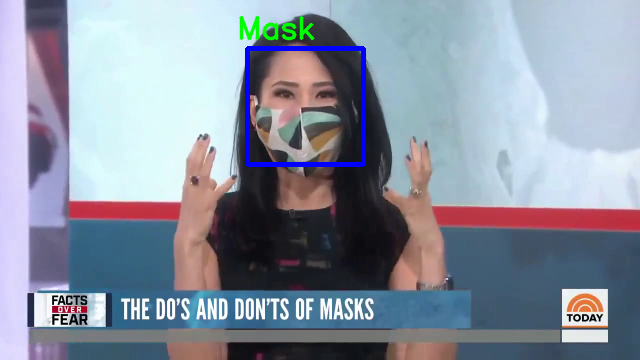

1/1 [==============================] - 0s 32ms/step


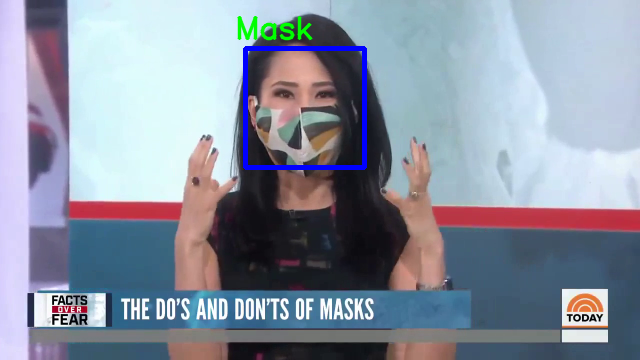

1/1 [==============================] - 0s 31ms/step


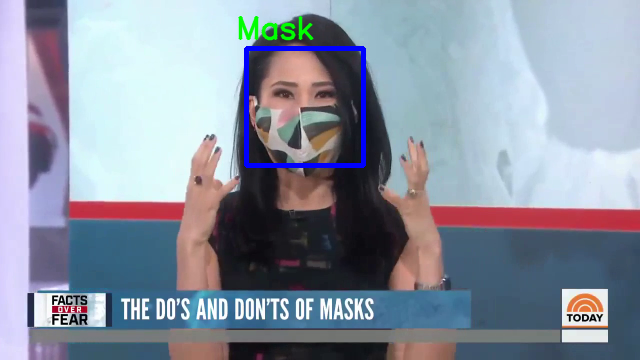

1/1 [==============================] - 0s 30ms/step


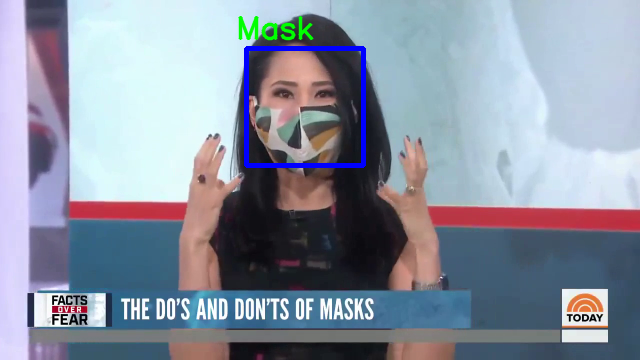

1/1 [==============================] - 0s 31ms/step


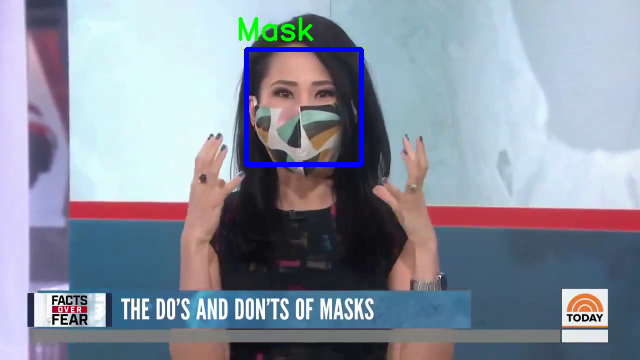

1/1 [==============================] - 0s 32ms/step


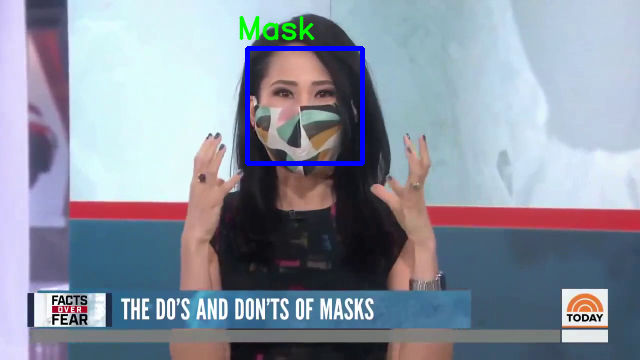

1/1 [==============================] - 0s 29ms/step


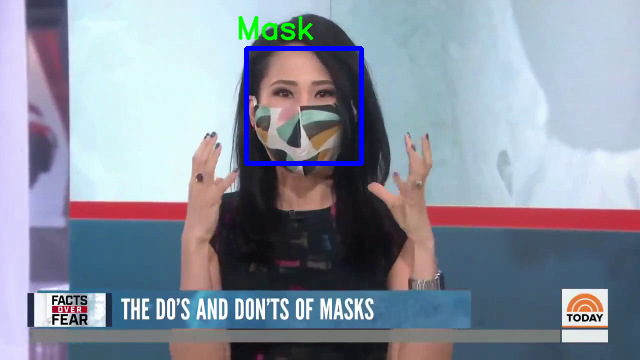

In [ ]:
import cv2
from tensorflow.keras.models import load_model
from keras_preprocessing.image import load_img , img_to_array
import numpy as np
from google.colab.patches import cv2_imshow
model =load_model('/content/drive/MyDrive/facemask/newmodel_model/newsaved_model.h5')

img_width,img_height = 150,150

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
cap = cv2.VideoCapture('/content/drive/MyDrive/facemask/video/Video.mp4')
img_count_full = 0

font = cv2.FONT_HERSHEY_SIMPLEX
org = (1,1)
class_label = ''
fontScale = 1
color = (255,0,0)
thickness = 2

while True:
    img_count_full +=1
    response , color_img = cap.read()
    
    if response == False:
        break
        
    scale = 50
    width = int(color_img.shape[1]*scale /100)
    height = int(color_img.shape[0]*scale/100)
    dim = (width,height)
    
    color_img = cv2.resize(color_img, dim, interpolation= cv2.INTER_AREA)
    gray_img = cv2.cvtColor(color_img,cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray_img, 1.1, 6)
    
    img_count = 0
    for (x,y,w,h) in faces:
        org = (x-10,y-10)
        img_count += 1
        color_face = color_img[y:y+h,x:x+w]
        cv2.imwrite('/content/drive/MyDrive/facemask/video/%dface%d.jpg'%(img_count_full,img_count),color_face)
        img = load_img('/content/drive/MyDrive/facemask/video/%dface%d.jpg'%(img_count_full,img_count),target_size=(img_width,img_height))
        img = img_to_array(img)
        img = np.expand_dims(img,axis=0)
        prediction = model.predict(img)
        
        if prediction==0:
            class_label = "Mask"
            color = (0,255,0)
            
        else:
            class_label = "No Mask"
            color = (0,0,255)
            
        cv2.rectangle(color_img,(x,y),(x+w,y+h),(255,0,0),3)
        cv2.putText(color_img, class_label, org, font, fontScale, color, thickness, cv2.LINE_AA)
        
    cv2_imshow(color_img)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
    
cap.release()
cv2.destroyAllWindows()